# Setup

reference: https://github.com/tylin/coco-caption/blob/master/cocoEvalCapDemo.ipynb

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
%cd /content/drive/MyDrive/results/coco-caption

%matplotlib inline
from pycocotools.coco import COCO
from pycocoevalcap.eval import COCOEvalCap
import matplotlib.pyplot as plt
import skimage.io as io
import pylab
pylab.rcParams['figure.figsize'] = (10.0, 8.0)

import json
from json import encoder
encoder.FLOAT_REPR = lambda o: format(o, '.3f')

/content/drive/MyDrive/results/coco-caption


# Load Dataset

In [ ]:
# Read omninet results
%cd /content/drive/MyDrive/results
import pickle
import nltk
nltk.download('punkt')

filename = 'coco-omninet-captions-first-300.txt'

with open(filename, 'r') as f:
    lines = f.readlines()

omninet_results = []

for i in range(0,len(lines)):
    omninet_results.append(lines[i][:-1])

/content/drive/MyDrive/results
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [ ]:
omninet_results = omninet_results[0:100]

In [ ]:
with open('./imageCaptions/lstm_result_ids2.pkl', 'rb') as f:
  lstm_result_ids2 = pickle.load(f)

In [ ]:
# Read adjective list
filename = 'anp_list.txt'

with open(filename, 'r') as f:
    lines = f.readlines()

anp = []

for i in range(0,len(lines)):
    anp.append(lines[i].rsplit(' ',1)[0])
  
anps = list(set(anp))

# Create generated sentence without adjectives

In [ ]:
# Setence without adjectives
senTocompare = []

for i in range(0,len(omninet_results)):
  tokens = nltk.tokenize.word_tokenize(omninet_results[i].lower())
  tokensNotadjs = [t for t in tokens if t not in anps + ['.']]
  withoutAdjs = " ".join(tokensNotadjs)
  senTocompare.append(withoutAdjs)

In [ ]:
# Load original captions
import json

with open('./captions_val2014.json') as json_file:
    captions_val2014 = json.load(json_file)

In [ ]:
# Find image ids
image_ids = [] 

for i in range(0,len(lstm_result_ids2)):
  for j in range(0,len(captions_val2014['images'])):
    if lstm_result_ids2[i] == captions_val2014['images'][j]['file_name']:
      image_ids.append(captions_val2014['images'][j]['id'])

In [ ]:
# Create Json file for generated sentences
import collections
sendict = []

for i in range(0,len(image_ids)):
  dict_temp = {'image_id': image_ids[i],
               'caption': omninet_results[i]}
  od = collections.OrderedDict(sorted(dict_temp.items(), reverse=True))
  sendict.append(od)

In [ ]:
with open('omninet_generated_sen.json', 'w') as outfile:
  json.dump(sendict, outfile)

# Load crated dataset

In [ ]:
# set up file names and pathes
# Data Directory
groud_truth = './coco-caption/annotations/captions_val2014.json'
generated_sen = './omninet_generated_sen.json'

## I don't know whether this stanford model is needed
# download Stanford models
%cd /content/drive/MyDrive/results/coco-caption
!./get_stanford_models.sh

/content/drive/MyDrive/results/coco-caption
Found Stanford CoreNLP.


In [ ]:
## COCO reads original COCO style file: captions_val2014.json 
## loadRes reads load Id and caption json file
## Example: {"image_id": 404464, "caption": "black and white photo of a man standing in front of a building"}

%cd /content/drive/MyDrive/results
ground_truth = COCO(groud_truth)
gen_sen = ground_truth.loadRes(generated_sen)

/content/drive/MyDrive/results
loading annotations into memory...
0:00:00.727297
creating index...
index created!
Loading and preparing results...     
DONE (t=0.04s)
creating index...
index created!


# Calculate evaluation metrics

In [ ]:
%cd /content/drive/MyDrive/results/coco-caption

/content/drive/MyDrive/results/coco-caption


In [ ]:
# create cocoEval object by taking coco and cocoRes
#cocoEval = COCOEvalCap(coco, cocoRes)
cocoEval = COCOEvalCap(ground_truth, gen_sen)

# evaluate on a subset of images by setting
# cocoEval.params['image_id'] = cocoRes.getImgIds()
# please remove this line when evaluating the full validation set
#cocoEval.params['image_id'] = cocoRes.getImgIds()
cocoEval.params['image_id'] = gen_sen.getImgIds()

# evaluate results
# SPICE will take a few minutes the first time, but speeds up due to caching
cocoEval.evaluate()

tokenization...
setting up scorers...
computing Bleu score...
{'reflen': 992, 'guess': [1012, 912, 812, 712], 'testlen': 1012, 'correct': [555, 205, 63, 21]}
ratio: 1.02016129032
Bleu_1: 0.548
Bleu_2: 0.351
Bleu_3: 0.212
Bleu_4: 0.130
computing METEOR score...
METEOR: 0.178
computing Rouge score...
ROUGE_L: 0.400
computing CIDEr score...
CIDEr: 0.488
computing SPICE score...
SPICE: 0.110


In [ ]:
# print output evaluation scores
for metric, score in cocoEval.eval.items():
    print '%s: %.4f'%(metric, score)

CIDEr: 0.4880
Bleu_4: 0.1296
Bleu_3: 0.2123
Bleu_2: 0.3511
Bleu_1: 0.5484
ROUGE_L: 0.3997
METEOR: 0.1775
SPICE: 0.1104


# Bad Result

length: 24
488979
ground truth captions
A herd of cattle standing on a pasture next to green crops.
Split pictures a tall green pasture and cows in brown grass.
This is a picture of a farm and its fields.
An image of several cows grazing the grass on an open farm land 
A cloudless day on a farm with cattle


generated caption (CIDEr score 0.0)
a wall is leaning beneath snow , stuck


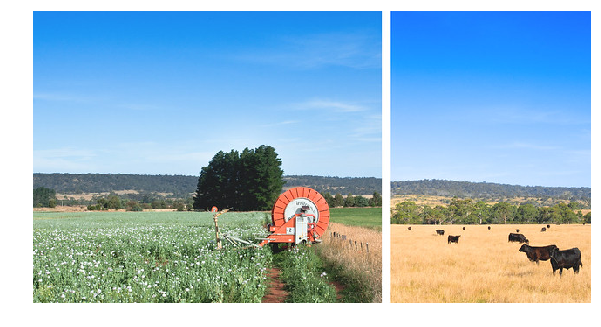

71738
ground truth captions
A man holding a motorcycle helmet is moving a chair in a public place.
A man holds a motorcycle helmet in a park.
A man carrying a chair and a helmet.
A man holding a helmet and carrying a chair.
A man with a fro kickin over a metal chair.


generated caption (CIDEr score 0.0)
a group of people sitting together on a bench


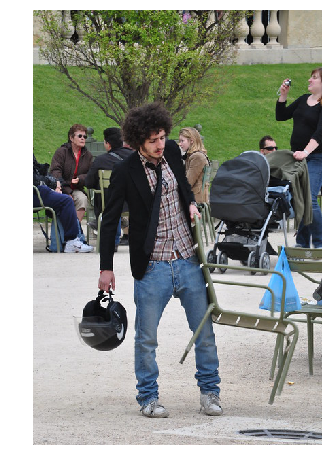

365642
ground truth captions
A young attractive woman sitting on a toilette on the side of a street.
A person sitting on a stool on the street.
A woman sitting on a bucket on the side of a street. 
A woman is sitting on a stool on a sidewalk.
A woman in a coat, sitting outside on a toilet.


generated caption (CIDEr score 0.0)
a man is swinging a baseball board in of a man


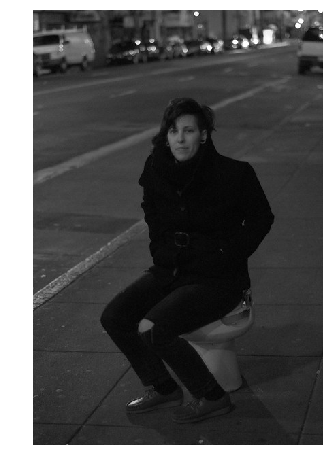

346703
ground truth captions
A man and woman standing over a dinner table with a cake.
A series of images showing a man holding a spoon over a lit candle, then serving a cake with it.
A series of pictures showing a flambe cake.
The people watch the man with the spoon over the candle. 
A person that is putting fire on a cake.


generated caption (CIDEr score 0.0)
a woman sits at a table


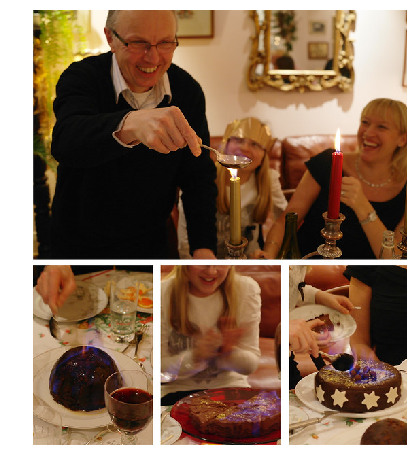

153392
ground truth captions
Many of the kites ascend high into the clouds.
A group of kites flying in the blue sky on a nice day. 
a blue sky that has a kite in it
a couple of kites are flying in the sky

Two views of bright objects floating through the blue sky.


generated caption (CIDEr score 0.0)
a picture of a commercial plane flying over the middle of sand
20069
ground truth captions
A child that is playing on a toy out in the park.
A child is playing in a recreational park.
A child playing on a moving playground set.
A child is playing on a yellow gym park set. 
a small kid plays in a park 


generated caption (CIDEr score 0.0)
a man is standing on a concrete bench


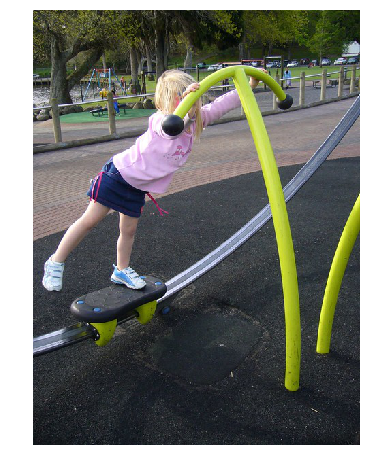

77954
ground truth captions
A man plays with a Frisbee while a crowd looks on. 
A man holding a neon yellow frisbee in his right hand.
This man is in the middle of an ultimate Frisbees competition 
A man that is getting ready to throw a frisbee.
A man winding up with a frisbee on a court.


generated caption (CIDEr score 0.0)
a game of people around a tennis ball


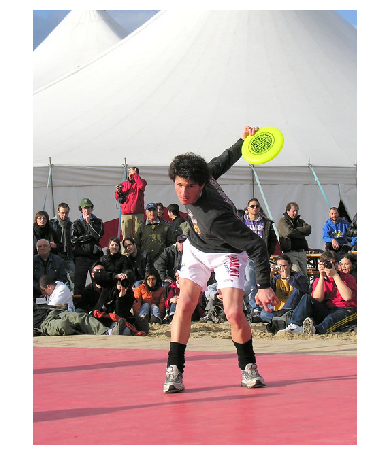

82052
ground truth captions
A man riding a skateboard down the middle of a street.
A person rides on a skateboard down the street.
Bottom half of a person on a skateboard with sky in background. 
A man on a skateboard riding in the street. 
A man's legs standing on a skateboard on a road


generated caption (CIDEr score 0.0)
a boy is being a frisbee in mid air


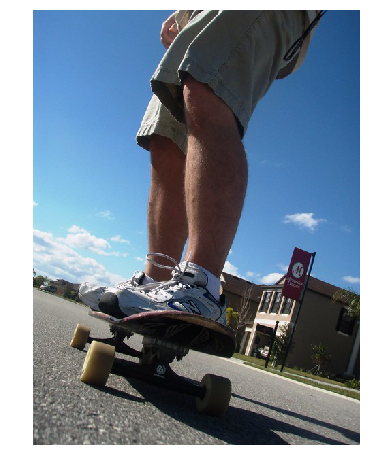

547041
ground truth captions
Two plastic containers have a soup and a salad in them.
Two containers, one with a salad, and another with some sort of other food in it.
Two containers with two different salads containing lettuce.
The salad is ready to eat for lunch. 
A tray of salad and a tray of salad toppings to the side.


generated caption (CIDEr score 0.0)
a plate filled with food and a sal bowl


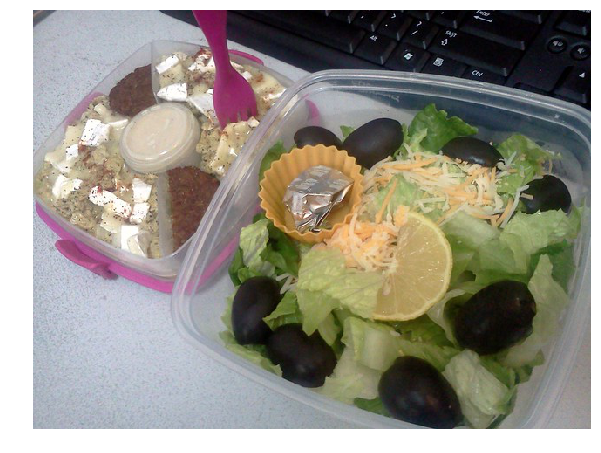

440093
ground truth captions
A man flying through the air while riding a skateboard.
a person jumping a skate board in the air 
Skateboarder and board in mid air at a contoured park.
There is a man jumping in the air on a skateboard.
A man performing a skateboard trick in a skateboard park.


generated caption (CIDEr score 0.0)
a man is playing a frisbee in a area


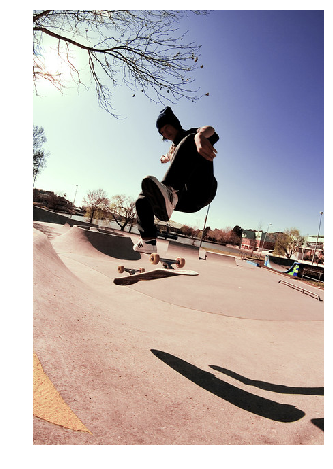

131361
ground truth captions
A man sitting at a table eating donuts.
A man holding a plate with a donut and other food item on it.
A man in sunglasses and jacket holding a plate of food.
Man in sunglasses and leather jacket with a plate of donuts.
A man with sunglasses is holding a plate of donuts.


generated caption (CIDEr score 0.0)
a man is eating food appears in a restaurant , eaten appears to be enjoying a cup of cup of food
246064
ground truth captions
A man with three cows on road next to trees.
A man holding a stick walks with three cows down a street.
A man runs with his 3 cattle along a street
A herder in white walking on a road with his cattle.
A man walking besides cows down a road. 


generated caption (CIDEr score 0.0)
a person riding a horse pastdle is ready to ride a ride a past


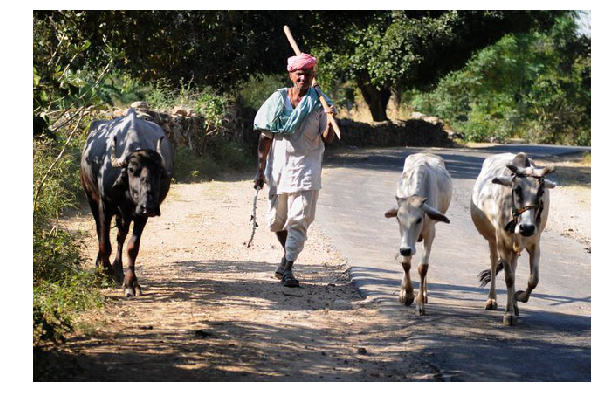

69496
ground truth captions
A plate full of food is ready to be eaten.
A white plate topped with stew and salad.
The meals is done and waiting to be eaten. 
A plate of food consisting of carrots and greens.
a white plate with a variety of meat and vegetables


generated caption (CIDEr score 0.0)
a food of a hot car is sitting on a table


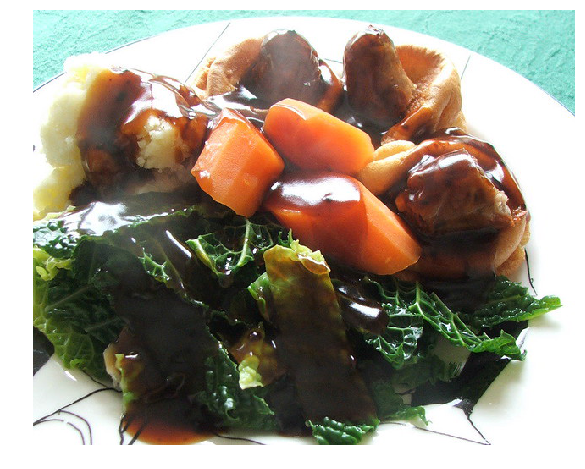

36238
ground truth captions
A pot full of beef and broccoli stew. 
A broccoli and beef dish with baby corn.
A pot of food contains meats and vegetables
Soup with broccoli  and meat cooking on a stove.
Broccoli and meat in a large pot that is ready for serving. 


generated caption (CIDEr score 0.0)
a picture of a meal , on the table


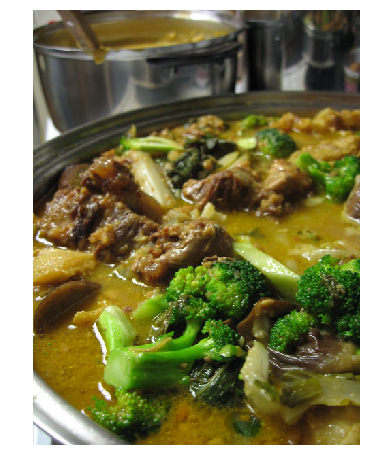

217517
ground truth captions
A city filled with lots of tall white buildings.
Cars, people, buildings and street lamps on a city street.
There is traffic on a busy city street. 
view of tall city buildings with cars and people walking by
People are walking and cars are driving in a city.


generated caption (CIDEr score 0.0)
a bunch of boats are traveling across to be a building


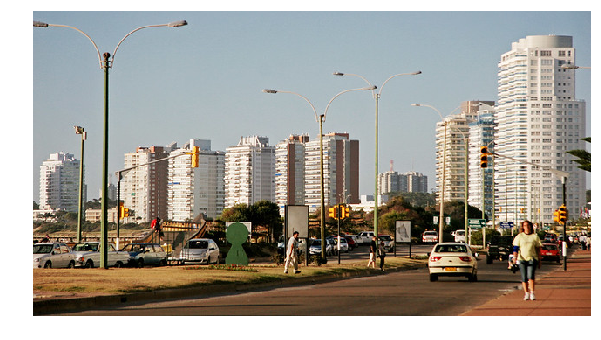

114164
ground truth captions
A herd of zebra walking across a dirt road.
Zebras are crossing a dirt road on the plain.
A herd of five zebras cross the dirt road.
Several zebras cross the road in the desert.
some zebras are walking across a dirt road


generated caption (CIDEr score 0.0)
a zebra and a zebra zebra standing in a field


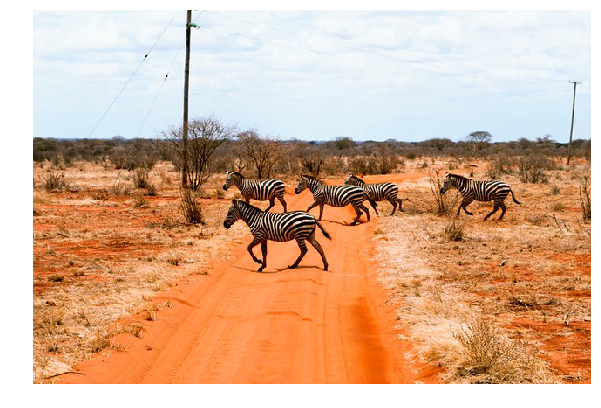

84410
ground truth captions
an odd looking blender with three serving glasses 
The vase is on display in the museum.
A drink maker sitting on a silver counter.
A blender on display next to some small glasses.
A blender sitting next to a  counter near a plaque.


generated caption (CIDEr score 0.0)
a woman holding a wiich into a woodench
427980
ground truth captions
A beautiful young woman eating a giant slice of cheese pizza.
an image of a girl eating a large slice of pizza
A person biting into a large piece of pizza
A women eating a very large piece of pizza.
A woman with long hair eating a slice of pizza


generated caption (CIDEr score 0.0)
a woman wearing a red shirt , tie is tieing dress


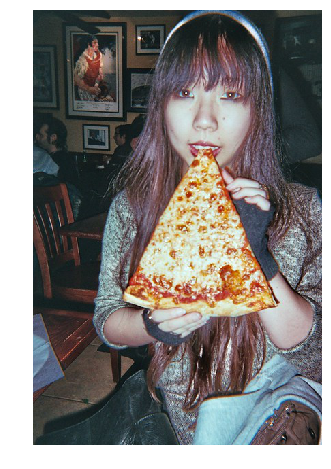

576987
ground truth captions
A person with his feet attached to a wake board, holding onto a para-sailing handle in the air.
A person windsurfing against a cloudless blue sky.
A person is hanging from a rope with a board attached to his feet.
A man flying through the air while riding a kite board.
a kite skier on a white board is in the air


generated caption (CIDEr score 0.0)
a man in a red shirt jumping up on the ground


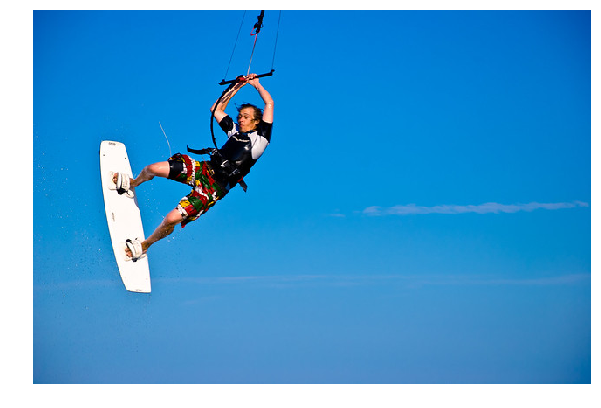

355297
ground truth captions
A surfer in the middle of a jump in the ocean
A man in the air while surfing in a water suit. 
A man riding a board into the air over foamy water.
A man in a black wetsuit is surfing in the water. 
A person on a surfboard in mid-air with water splashing under him.


generated caption (CIDEr score 0.0)
a man is sitting on a tree


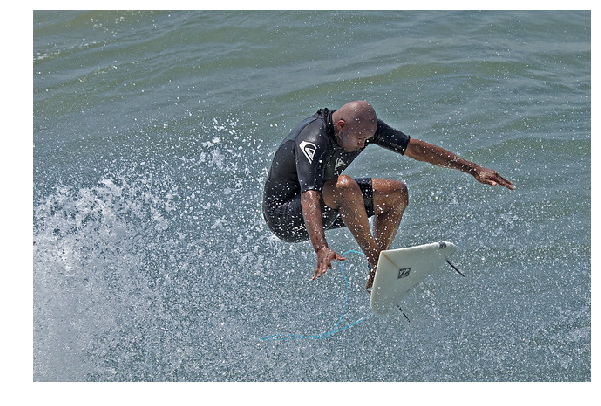

144373
ground truth captions
A person with a blue ring eating a doughnut
Two hands holding a half eaten jelly filled donut.
childs hands holding powdered sugar donut with chocolate inside
a close up of a person holding a jelly filled doughnut
A person eating a very large donut with two hands.


generated caption (CIDEr score 0.0)
a plate of food makes a man sitting on a table
516602
ground truth captions
A small calf is in a pen with bails of hay.
A truck with an animal, hay, and other containers in the back.
An old metal box with rolls of twine
A cow in the back of a large truck.
A truck with some random things in the back


generated caption (CIDEr score 0.0)
a picture of a hot cat is sitting on a doorwalk


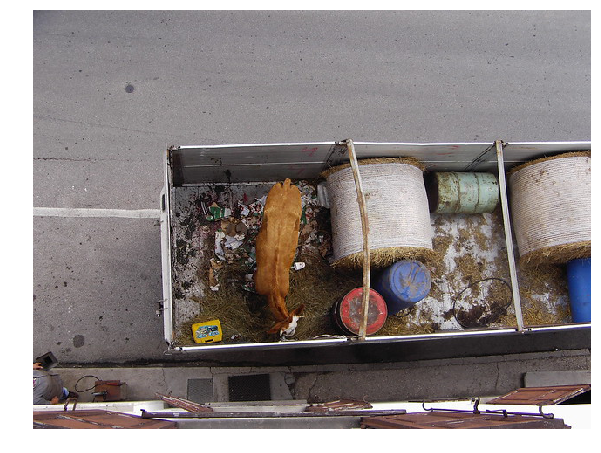

175611
ground truth captions
A person with a pair of scissors cutting into a cigar.
A wood working trimming the wood with pair of scissors.
An old hand is cutting cigars with scissors.
A pair of hands with scissors cutting a cigar.
Hands cutting a piece of paper with wood shavings on a table.


generated caption (CIDEr score 0.0)
a man holding a large apple box of pizza


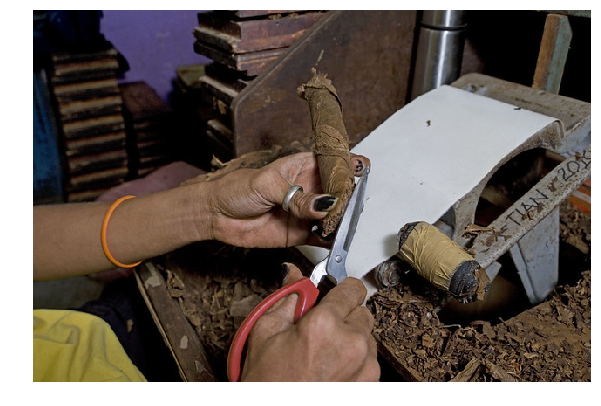

404988
ground truth captions
A line of benches that are snow covered
Several wooden benches, all lined up, lightly covered in snow.
Snow covered benches with bushes in the background
The benches along the sidewalk are covered with snow.
A line of outdoor benches are covered in snow. 


generated caption (CIDEr score 0.0)
a man sitting on a bench looking up at a board


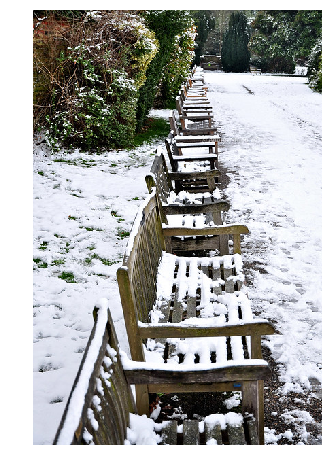

In [ ]:
# Bad result of OmniNet
evals = [eva for eva in cocoEval.evalImgs if eva['CIDEr']<0.1]
print 'length:', len(evals)

for i in range(0,len(evals)):
  imgId = evals[i]['image_id']
  print imgId
  print 'ground truth captions'
  annIds = ground_truth.getAnnIds(imgIds=imgId)
  anns = ground_truth.loadAnns(annIds)
  ground_truth.showAnns(anns)

  print '\n'
  print 'generated caption (CIDEr score %0.1f)'%(evals[0]['CIDEr'])
  annIds = gen_sen.getAnnIds(imgIds=imgId)
  anns = gen_sen.loadAnns(annIds)
  ground_truth.showAnns(anns)

  img = ground_truth.loadImgs(imgId)[0]
  try:
    I = io.imread(img['url'])
  except:
    continue
  plt.imshow(I)
  plt.axis('off')
  plt.show()

# Good result

length: 29
314370
ground truth captions
A kitchen filled with clutter all over it's counter.
 A kitchen is cluttered with cooking supplies, especially eggs
a kitchen with a stove and counter tops and shelves filled with food.
A large variety of food spread out on a counter.
A kitchen counter is stacked up with food from the store.


generated caption (CIDEr score 0.6)
a kitchen filled with a cup of coffee ut appl shel decorations


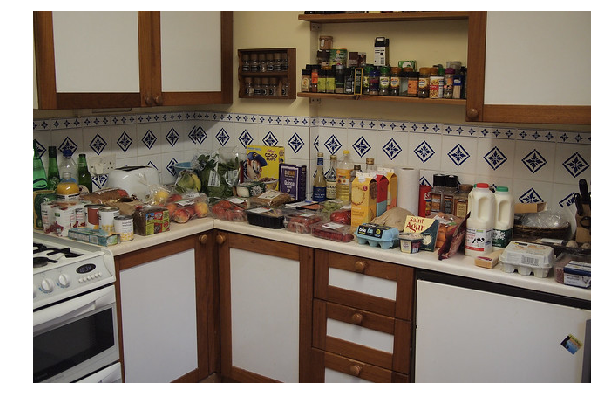

172556
ground truth captions
An instructor teaching people how to surf on the beach
Four people learning how to surf on a sandy beach
A group of people pretend to surf on the beach next to hotels.
A group of young people standing on a beach next to a surfboard.
people standing on a beach being taught how to surf


generated caption (CIDEr score 0.6)
a man is surfing with a young man riding a surfboard on the beach


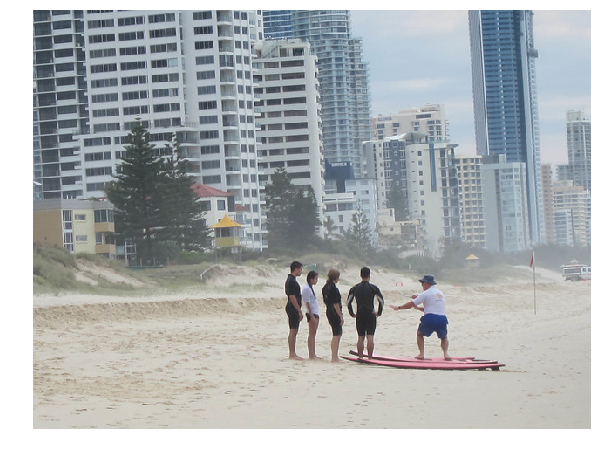

480793
ground truth captions
The walls outside the small bathroom have a blue tint.
A bathroom with toilet, shower, and cabinets in it.
A white toilet sitting next to a shower.
A bathroom has a white counter top and shower curtain.
a bathroom with a sink and a toilet


generated caption (CIDEr score 0.6)
a bathroom with a shower and a curtal tiles and a shower


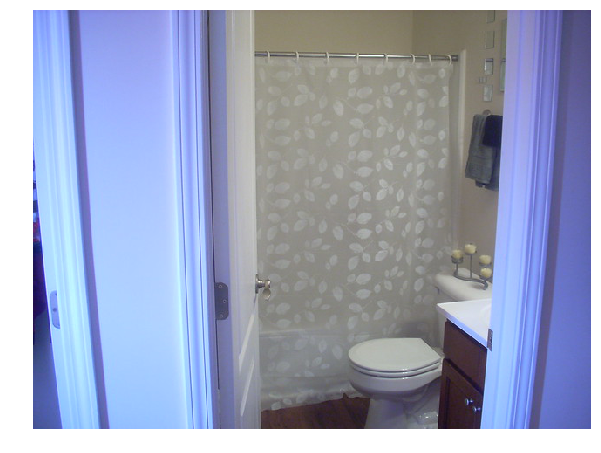

58915
ground truth captions
A large clock and a sign on top of a building.
a big sign sits above a building 
Public Market sign with clock near farmer sign.
A sign for a market is displayed on a roof.
a red sign and a clock above a building


generated caption (CIDEr score 0.6)
a red clock sign outside over a building


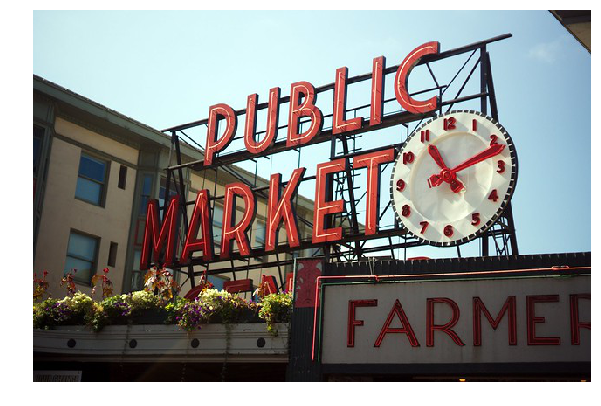

372807
ground truth captions
A zebra standing on top of a grass covered field.
The zebra is looking directly into the camera lense,
A front view of a zebra looking at the camera.
A zebra that is standing in the grass.
A zebra standing in the grass near trees.


generated caption (CIDEr score 0.6)
a picture of a zebra standing in a field


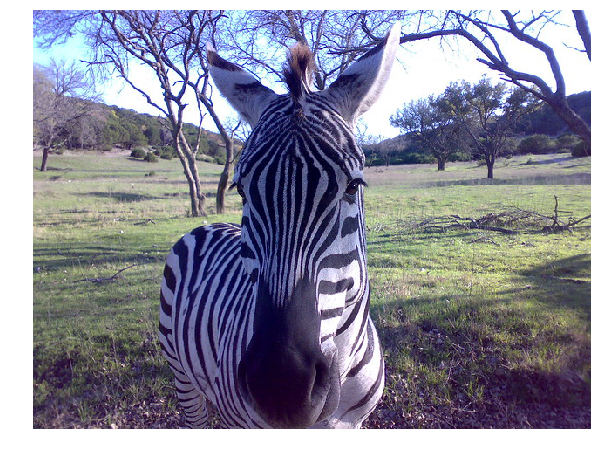

183374
ground truth captions
A group of people who are standing near each other with umbrellas.
some people are walking on the street with umbrellas
A mothernand child walking done a sidewalk holding an umbrella.
a woman and her daughter walking under an umbrella 
this is a crowd of people on the sidewalk


generated caption (CIDEr score 0.6)
a group of people walking down a street


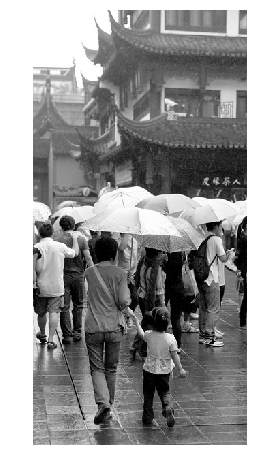

375915
ground truth captions
Pizza on a tray on the table outside next to plates and wine glass
A table outside with a pizza on it with several toppings. 
Pizza type meal set out on a wooden table with plates.
A pizza sitting on an outdoor table in the sun
A table that has pizza, wine, a candle, plates, and another food dish on it. 


generated caption (CIDEr score 0.6)
a man sitting on a table with a slice of pizza


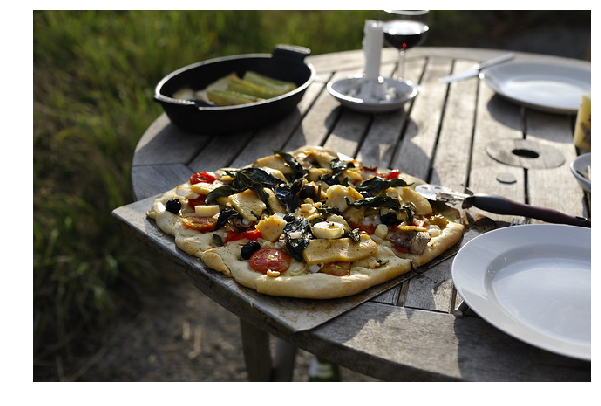

535668
ground truth captions
A baseball player bending over to hit a ball.
A man swinging a bat during a baseball game.
some baseball players are playing baseball on a field
A baseball player swinging a bat at a pitch
a baseball player hitting a baseball at home base


generated caption (CIDEr score 0.6)
a man is swinging a baseball bat in the photo


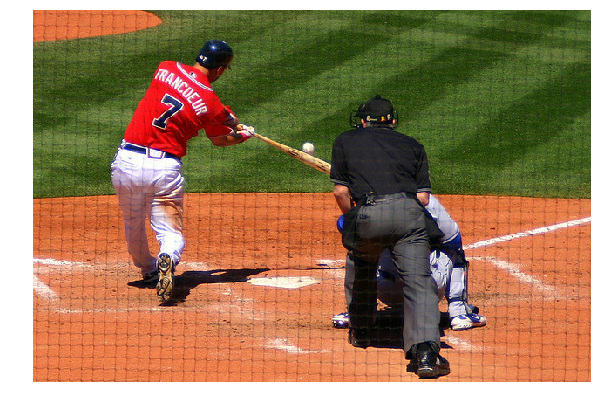

235672
ground truth captions
a group of people sitting down with umbrellas
a number of people holding umbrellas near one another 
People walking through street with tents outside and rain
a few people that has some umbrellas in hand
A group of people standing around a farmers market.


generated caption (CIDEr score 0.6)
a group of people sitting around a large bus


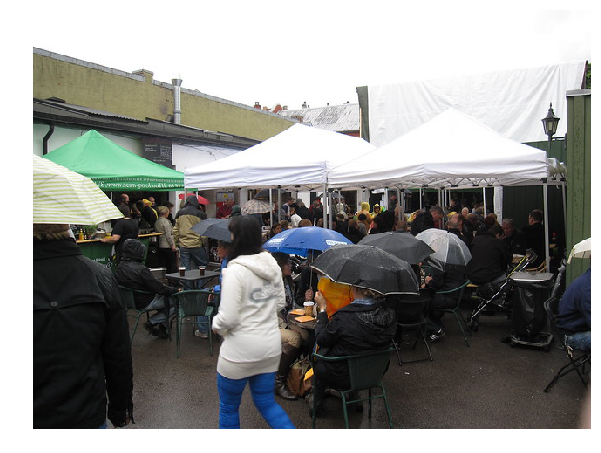

72873
ground truth captions
A sparse hospital room with an open window.
A hospital room that has the window open.
this is a room with a tile floor
An empty hospital room is seen in this image.
An all white room in an institution with a hospital bed.


generated caption (CIDEr score 0.6)
a living room with a bed , bed and a window


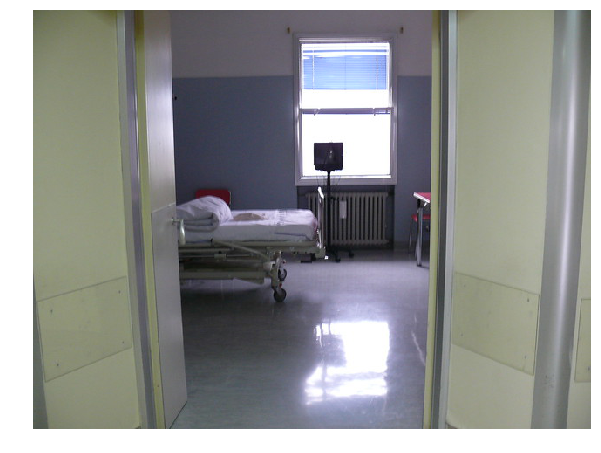

273067
ground truth captions
A red city bus with a red bow attached.
A public bus parked on a concrete driveway.
A silver and red bus parked in a parking lot.
The people are standing outside beside the bus.
A gray and red bus parked next to a body of water.


generated caption (CIDEr score 0.6)
a red bus drives over a road


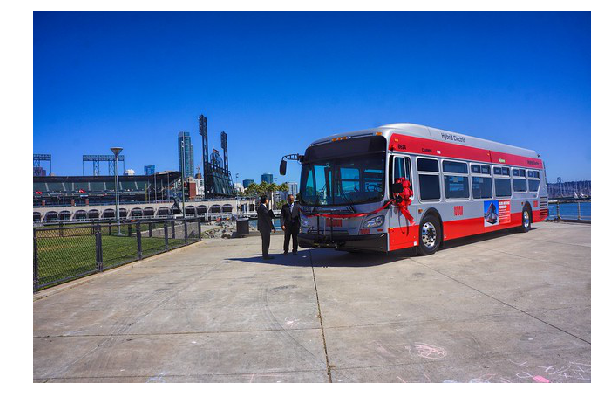

19663
ground truth captions
A woman holding a tennis racquet on a tennis court.
The woman is hitting tennis balls with a tennis racket.
A tennis player in blue swings back racket with one hand to return a shot.
a lady practicing hitting tennis balls with a machine
A tennis player swinging a racket at a tennis ball.


generated caption (CIDEr score 0.6)
a woman is playing a tennis ball on a court


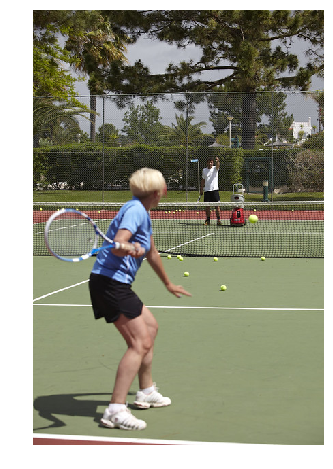

28110
ground truth captions
A giraffe walking through the forest in the wild. 
A giraffe is walking in the open grass land
There is a giraffe walking through some trees
A giraffe walks on the grass through some trees. 
A giraffe grazing a field with trees on a hill.


generated caption (CIDEr score 0.6)
a giraffe standing next to a horse in a field


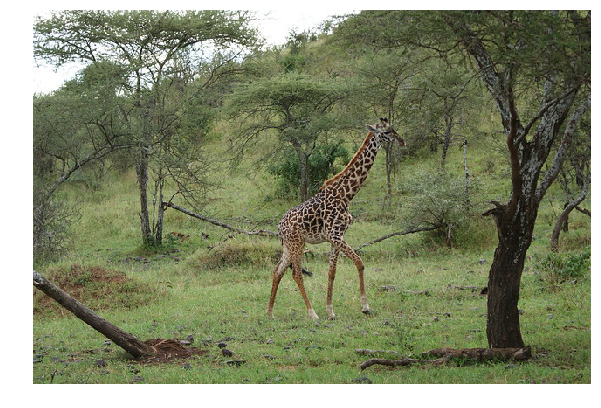

493805
ground truth captions
Two giraffes in a zoo look at their surroundings
Two giraffes are standing at a wild animal park. 
Two giraffes standing close together near a pile of rocks.
Two giraffes on grassy field with rocks and trees around.
Two giraffes standing together in an outdoor park.


generated caption (CIDEr score 0.6)
two giraffes in a field near a tree


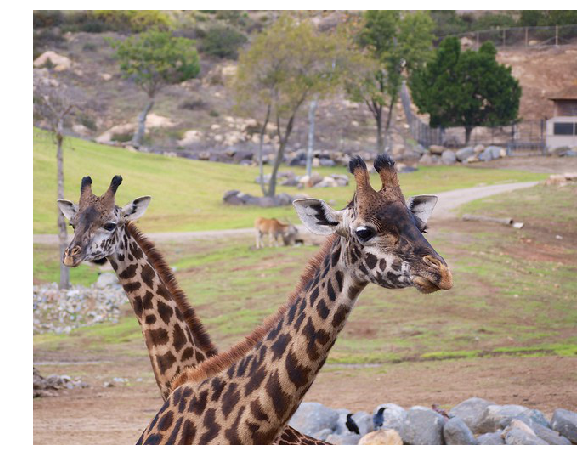

470256
ground truth captions
A kitchen area with sink, dishwasher and refrigerator.
This is a picture of a kitchen with a fridge, sink, and dishwasher.
A washing machine is sitting next to a dishwasher in a kitchen.
A small kitchen has teal green walls and a small window.
an empty kitchen that also has a dishwasher and washing machine


generated caption (CIDEr score 0.6)
a shot of a kitchen with a sink stove sink


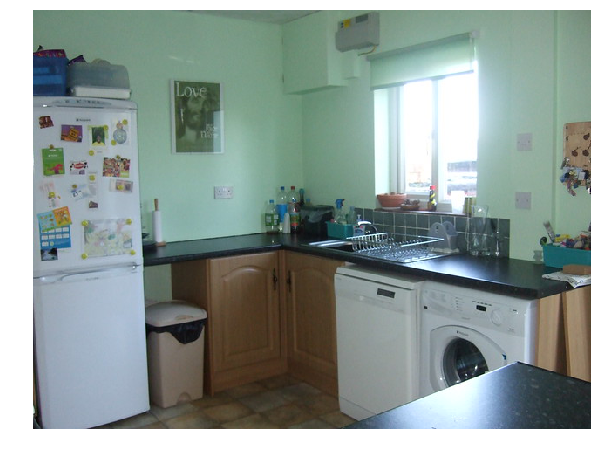

204036
ground truth captions
A yellow and blue bus parked at the end of a street.
The truck is parked behind the big bus.
A photo looking down at a parking area with garbage and old vehicles.
There is a bus and a truck parked near two buildings.
A bus and a truck parked in a messy lot.


generated caption (CIDEr score 0.6)
a messy bus is parked in a city


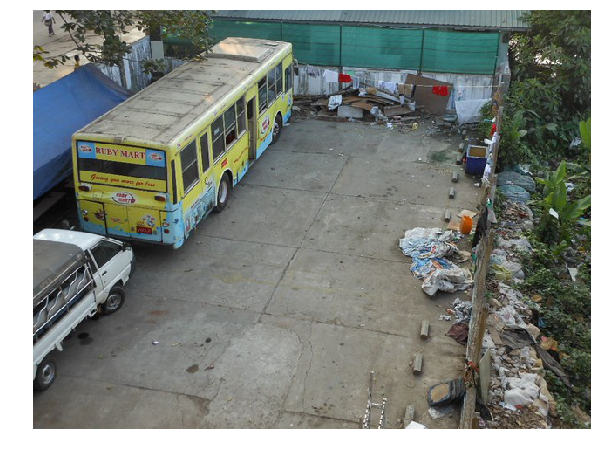

535307
ground truth captions
A sandy beach next to the ocean under a sky filled with kites.
The people on the beach are flying their kites. 
Kites are flying over a pebbled beach as people gather on the shore.
Several people at the beach flying some kites.
People are on the beach with kites flying.


generated caption (CIDEr score 0.6)
a group of kites are flying over a beach


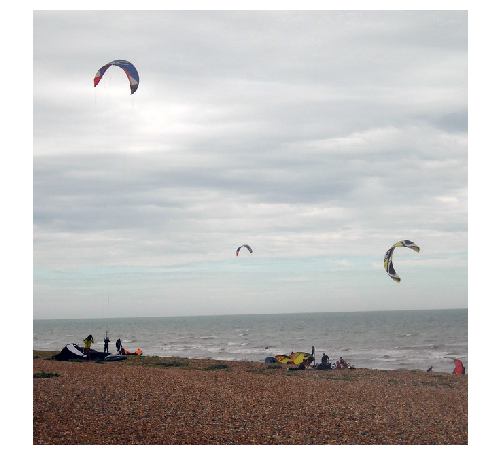

535821
ground truth captions
A horse behind a fence looking into a camera. 
A gray horse stands next to a barbed-wire fence.
A white horse looking over a wire fence.
A horse standing in a paddock wearing a halter.
A horse in a pen looks over a fence. 


generated caption (CIDEr score 0.6)
a horse feeds in the middle of a tree
368459
ground truth captions
Two people riding a ski lift with snowboards on their feet. 
Two people are sitting in a chair lift with their feet on a snow board and skis dangling 
a couple sitting on a bench and headed up a snow mountain
Two people sit on a ski lift with snowboards.
Two snowboarders ride the ski lift to the top of the mountain. 


generated caption (CIDEr score 0.6)
a man is standing on a ski slope


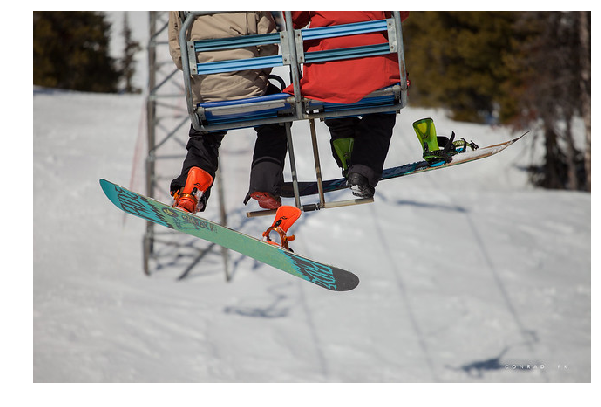

247639
ground truth captions
a man with white swim trunks is surfing
A man is catching a wave on a surf board.
A man on a surfboard riding the top of a wave.
A surfer rides a wave standing sideways on his board. 
A man surfing a wave on his surf board.


generated caption (CIDEr score 0.6)
a man is surfing on the water


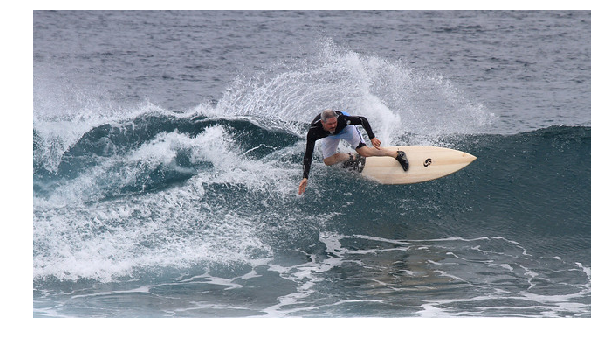

306524
ground truth captions
A beautiful tower building with a big clock on it.
A clock is posted on the front of a building.
Clock on the side of a stately church.
A large charge with a clock in the middle of the building.
There is a very large castle like building with a clock in the middle


generated caption (CIDEr score 0.6)
a large clock with people on top of a clock and cemetery


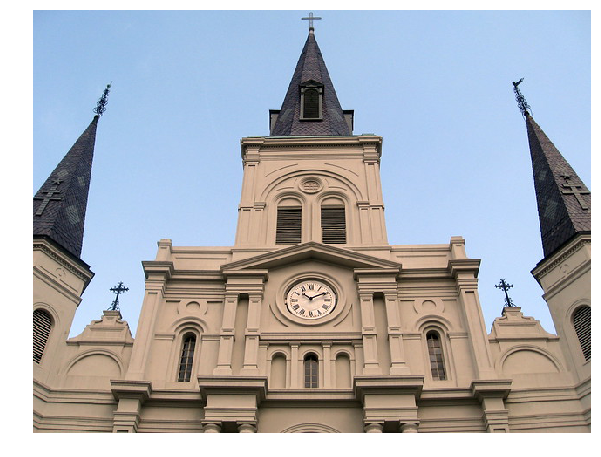

414078
ground truth captions
a dark cat with green eyes is laying on a blue bed
a kitty l with green eyes laying on a blue comforter  
A cat with a serious look on its face sitting on a bed.
A close up of a black and brown cat laying on a bed..
A green eyed cat is on a blue bedspread.


generated caption (CIDEr score 0.6)
a cat laying on a couch near a purple blanket
521613
ground truth captions
A living area with chairs, a sofa and a fireplace.
A couch, coffee table, and stand sitting in a living room by a window.
a living room with a lot of chairs and a rug 
A brightly lit and empty modern living room.
A neatly arranged living room with chairs, tables, paintings and a sofa.


generated caption (CIDEr score 0.6)
a living room with a television table table , chairs , television , wood table


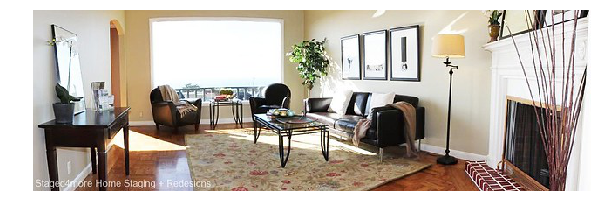

510864
ground truth captions
A person in a wet suit is surfing 
A woman riding a surfboard on top of rapid water.
A woman on a surfboard is riding a wave
a man that is on a surfboard on some water
a woman on a surfboard riding a wave


generated caption (CIDEr score 0.6)
a man on a surfboard riding a wave in the water


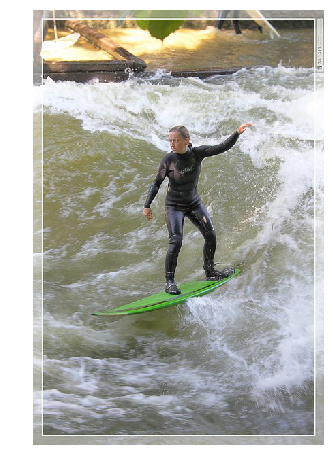

20381
ground truth captions
A train traveling down tracks next to a  building.
A train going down the train tracks in the city. 
A train driving down the tracks next to a platform.
The train has made an important stop at the station.
The train is going down the railroad tracks. 


generated caption (CIDEr score 0.6)
a train station traveling past a train , past a building


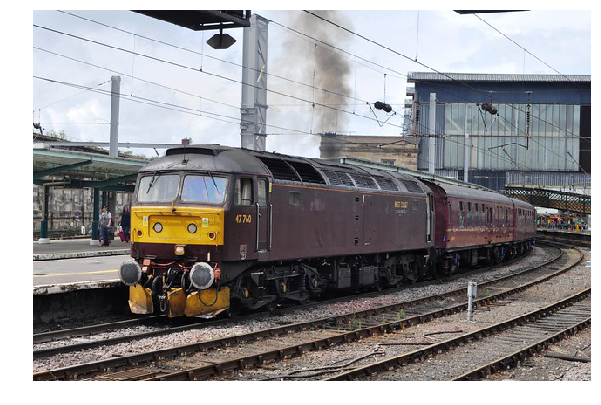

388528
ground truth captions
A toilet with the seat open sitting in a bathroom. 
A square shaped toilet and a wall urinal in a bathroom.
Square white toilet and urinal in a men's bathroom.
a small toilet with a square lid and low to the floor
An open toilet seat next to a urinal. 


generated caption (CIDEr score 0.6)
a bathroom with a tub , toilet and sink


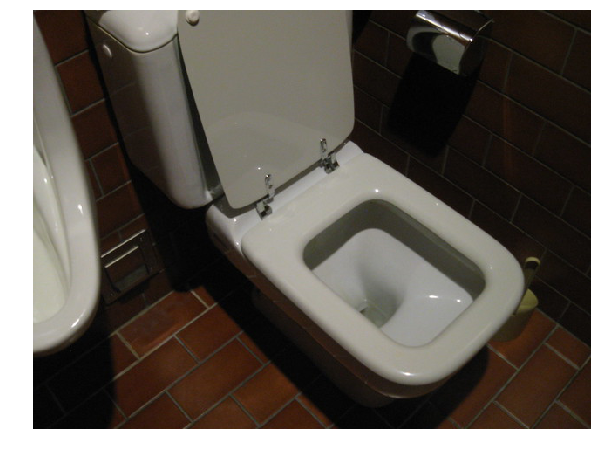

160195
ground truth captions
There is two men riding on a skateboard on the street.
Two men who are skateboarding down a street.
Two friends are skateboarding down the street to their next destination.
A man riding a skateboard next to another young man also on a skateboard.
A man on a skateboard, riding on a sidewalk area while another man on a skateboard rides beside him.


generated caption (CIDEr score 0.6)
a man riding a skateboard down a street in of a man


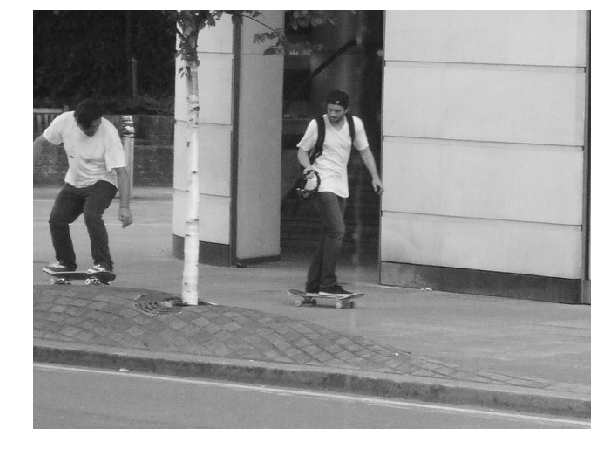

250309
ground truth captions
A woman in a white shirt is playing tennis.
A woman taking a swing at a tennis ball
A girl is running and swinging a tennis racket.
A girl on a tennis court wears black shorts and holds her tennis racket.
A beautiful blond holding a tennis racquet on a  court.


generated caption (CIDEr score 0.6)
a woman hitting a tennis ball with a tennis racquet


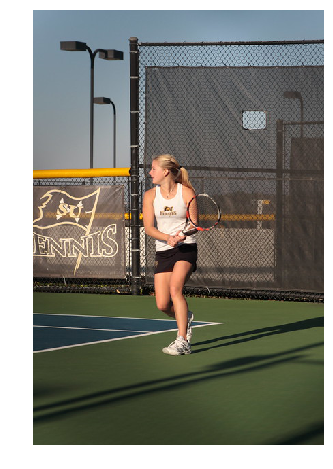

515022
ground truth captions
A red and yellow train on the train tracks.
A train coming on the track in a train station 
The red and orange train is pulling up to the platform.
a big rain drives under a bridge 
A train is pulled up near a loading station.


generated caption (CIDEr score 0.6)
a train is traveling out of a building


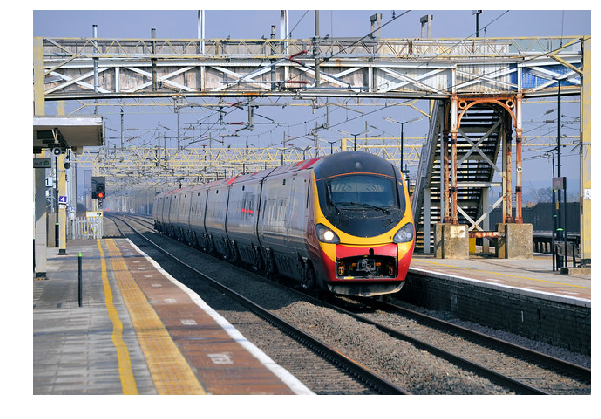

In [ ]:
# Good result of OmniNet
evals = [eva for eva in cocoEval.evalImgs if eva['CIDEr']>0.6]
print 'length:', len(evals)


for i in range(0,len(evals)):
  imgId = evals[i]['image_id']
  print imgId
  print 'ground truth captions'
  annIds = ground_truth.getAnnIds(imgIds=imgId)
  anns = ground_truth.loadAnns(annIds)
  ground_truth.showAnns(anns)

  print '\n'
  print 'generated caption (CIDEr score %0.1f)'%(evals[0]['CIDEr'])
  annIds = gen_sen.getAnnIds(imgIds=imgId)
  anns = gen_sen.loadAnns(annIds)
  ground_truth.showAnns(anns)

  img = ground_truth.loadImgs(imgId)[0]
  try:
    I = io.imread(img['url'])
  except:
    continue
  plt.imshow(I)
  plt.axis('off')
  plt.show()


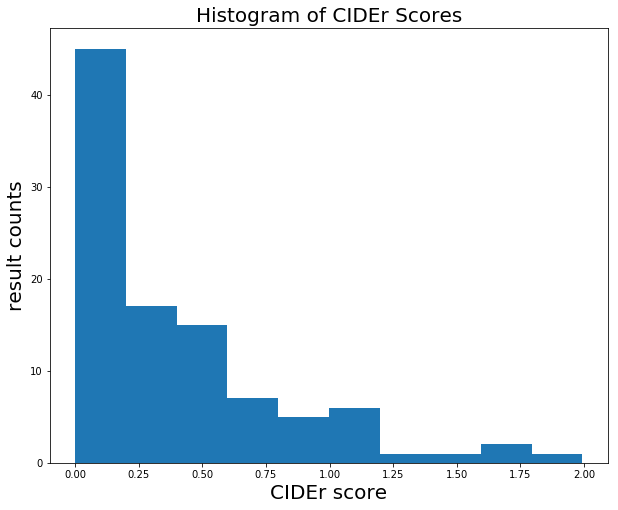

In [ ]:
# plot score histogram
ciderScores = [eva['CIDEr'] for eva in cocoEval.evalImgs]
plt.hist(ciderScores)
plt.title('Histogram of CIDEr Scores', fontsize=20)
plt.xlabel('CIDEr score', fontsize=20)
plt.ylabel('result counts', fontsize=20)
plt.show()

In [ ]:
'''
# save evaluation results to ./results folder
import os
%cd /content/drive/MyDrive/results/evalresults
evalImgsFile = './omninet_imgresults.json'
evalFile = './omninet_evalresults.json'

json.dump(cocoEval.evalImgs, open(evalImgsFile, 'w'))
json.dump(cocoEval.eval,     open(evalFile, 'w'))
'''

/content/drive/MyDrive/results/evalresults
